In [1]:
import json
import matplotlib.pyplot as plt
from wordcloud import WordCloud
import os
import requests
import operator

In [2]:
followers_analysis_json = {}

In [3]:
# Json path
json_path = '../../data/followers_timeline.json'

In [4]:
# Open json file
followers_timeline_file = open(json_path, 'r')
# Load json file
followers_timeline = json.load(followers_timeline_file)

In [5]:
print(json.dumps(followers_timeline, indent=4))

{
    "followers_timeline": {
        "1132988843609808899": {
            "1087253284589572096": {
                "data": [
                    {
                        "id": "1462498399287226370",
                        "text": "RT @justAlesh: .@KygoMusic you absolutely have to take a look at this project called @Luxaiart \n\nSo unique and different than just a regula\u2026"
                    },
                    {
                        "id": "1462498359269281800",
                        "text": "RT @justAlesh: Galactica collection is definitely my favorite piece of @Luxaiart \n\nThey are over 50% Sold out, but you can still grab one f\u2026"
                    },
                    {
                        "id": "1462498317254995980",
                        "text": "RT @MrMadCrypto: I\u2019ll give $250 to one person in 72 hrs \n\n- RT &amp; Follow | @MetaVPad"
                    },
                    {
                        "id": "1462498285432848385",
            

In [6]:
followers_timeline["followers_timeline"]

{'1132988843609808899': {'1087253284589572096': {'data': [{'id': '1462498399287226370',
     'text': 'RT @justAlesh: .@KygoMusic you absolutely have to take a look at this project called @Luxaiart \n\nSo unique and different than just a regula…'},
    {'id': '1462498359269281800',
     'text': 'RT @justAlesh: Galactica collection is definitely my favorite piece of @Luxaiart \n\nThey are over 50% Sold out, but you can still grab one f…'},
    {'id': '1462498317254995980',
     'text': 'RT @MrMadCrypto: I’ll give $250 to one person in 72 hrs \n\n- RT &amp; Follow | @MetaVPad'},
    {'id': '1462498285432848385',
     'text': 'RT @angel_funsized: $100 • 24 hours\n\nRT + Follow @MetaVPad https://t.co/4fegmEuZZ6'},
    {'id': '1462498253916852224',
     'text': 'RT @ladyincrypto: $1,000 GIVEAWAY ~ 7 DAYS 🔥\n\n- RT &amp; Follow @iamZatoshi \n\n🌿 $500 x 2 winners!'},
    {'id': '1462498227421425675',
     'text': 'RT @AlexxNFT: Giving away $100 to 1 random person who retweets &amp; follows me 

In [7]:
num_folowers = 0
for i in followers_timeline["followers_timeline"]:
	num_folowers += len(followers_timeline["followers_timeline"][i])
num_folowers

757

In [8]:
search_words = ["trophy", "skin"
                "fur",
                "dragon",
                "pelt",
                "tusk",
                "ivory",
                "scale",
                "taxidermy",
                "rug",
                "hide",
                "bone",
                "meat",
                "delicacy",
                "medicine",
                "live",
                "pangolin",
                "leopard",
                "rhino",
                "sungazer",
                "lizard",
                "crocodile",
                "alligator",
                "parrot",
                "snake",
                "python",
                "yellow material",
                "white plastic",
                "jelly",
                "aloo",
                "kola",
                "australian teddy bear",
                "stripped t-shirt",
                "four wheeler",
                "antique",
                "mammoth",
                "carved",
                "sale",
                "selling",
                "price",
                "xiangya",
                "african material",
                "ANTEBELLUMELEG1"]
suspicious_tweets_word_list = []
tweets_with_search_words = []
suspicious_tweets_word_count = {}
suspicious_tweet_count = 0
total_tweets_count = 0
followers = 0
for word in search_words:
    suspicious_tweets_word_count[word] = 0
for i in range(1000):
    try:
        followers_timeline_file = open("../../data/followers_timeline_{}.json".format(str(i)), 'r')
        print("Working on file {}".format(str(i)))
    except:
        print("File not found")
        break
    # Load json file
    followers_timeline = json.load(followers_timeline_file)
    for user in followers_timeline["followers_timeline"]:
        # print(user)
        for follower in followers_timeline["followers_timeline"][user]:
            followers += 1
            # print(follower)
            try:
                tweet_timeline = followers_timeline["followers_timeline"][user][follower]["data"]
                for tweet in tweet_timeline:
                    try:
                        tweet_text = tweet['text']
                        tweet_id = tweet['id']
                        tweet_suspicious = False
                        bad_tweet = {}
                        total_tweets_count += 1
                        for search_word in search_words:
                            if search_word in tweet_text.lower():
                                # print(tweet_text)

                                
                                bad_tweet['user'] = user
                                bad_tweet['tweet'] = tweet_text
                                bad_tweet['id'] = tweet_id
                                
                                if tweet_suspicious == False:
                                    bad_tweet['suspicious_word'] = [search_word]
                                    suspicious_tweets_word_list.append([search_word])
                                    suspicious_tweet_count += 1
                                else:
                                    suspicious_tweets_word_list[-1].append(search_word)
                                    bad_tweet['suspicious_word'].append(search_word)
                                tweet_suspicious = True
                                suspicious_tweets_word_count[search_word] += 1
                        # If bad tweet is not empty
                        if len(bad_tweet) > 0:
                            tweets_with_search_words.append(bad_tweet)
                    except:
                        pass
            except:
                pass
followers_analysis_json['tweets_with_search_words'] = tweets_with_search_words
# print("Tweets with search words: ", tweets_with_search_words",)


Working on file 0
Working on file 1
Working on file 2
Working on file 3
Working on file 4
Working on file 5
Working on file 6
Working on file 7
Working on file 8
Working on file 9
Working on file 10
Working on file 11
Working on file 12
Working on file 13
Working on file 14
Working on file 15
Working on file 16
Working on file 17
Working on file 18
Working on file 19
Working on file 20
Working on file 21
Working on file 22
Working on file 23
Working on file 24
Working on file 25
Working on file 26
Working on file 27
Working on file 28
Working on file 29
Working on file 30
Working on file 31
Working on file 32
Working on file 33
Working on file 34
Working on file 35
Working on file 36
Working on file 37
Working on file 38
Working on file 39
Working on file 40
Working on file 41
Working on file 42
Working on file 43
Working on file 44
Working on file 45
Working on file 46
Working on file 47
Working on file 48
Working on file 49
Working on file 50
Working on file 51
Working on file 52
Wor

In [18]:
print("Suspicious tweet count: ", suspicious_tweet_count)
print("Total followers: ", followers)
print("Total tweets: ", total_tweets_count)
print("Average tweets per follower: ", total_tweets_count/followers)
print("Percentage of suspicious tweets: ", (suspicious_tweet_count/total_tweets_count)*100)


Suspicious tweet count:  113175
Total followers:  13068
Total tweets:  899573
Average tweets per follower:  68.83784817875727
Percentage of suspicious tweets:  12.58096897083394


In [10]:
for i in suspicious_tweets_word_list:
	if len(i) > 1:
		print(i)

['sale', 'price']
['live', 'sale']
['sale', 'price']
['sale', 'price']
['sale', 'price']
['sale', 'price']
['sale', 'price']
['sale', 'price']
['sale', 'price']
['sale', 'price']
['live', 'sale']
['live', 'rhino']
['live', 'price']
['rug', 'sale']
['sale', 'price']
['sale', 'price']
['selling', 'price']
['selling', 'price']
['sale', 'selling']
['dragon', 'selling', 'price']
['selling', 'price']
['selling', 'price']
['sale', 'selling']
['dragon', 'live']
['dragon', 'live']
['sale', 'selling']
['selling', 'price']
['sale', 'price']
['dragon', 'snake']
['bone', 'antique']
['parrot', 'python']
['selling', 'price']
['scale', 'sale']
['rug', 'live']
['sale', 'price']
['tusk', 'mammoth']
['live', 'sale']
['ivory', 'rug']
['live', 'sale']
['dragon', 'snake']
['live', 'price']
['rug', 'sale']
['live', 'price']
['dragon', 'live']
['antique', 'carved']
['dragon', 'antique']
['sale', 'price']
['dragon', 'scale']
['rug', 'price']
['scale', 'live']
['sale', 'price']
['rug', 'sale']
['rug', 'sale']
[

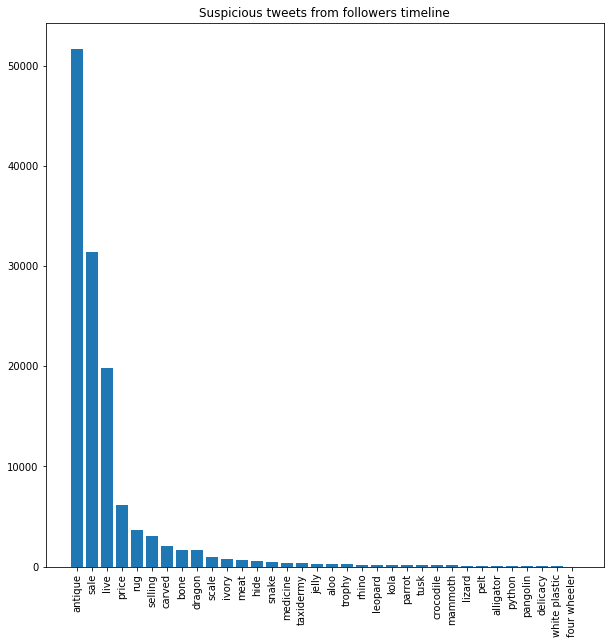

In [11]:
# Sort suspicious_tweets_word_count
suspicious_tweets_word_count_sorted = sorted(suspicious_tweets_word_count.items(), key=operator.itemgetter(1), reverse=True)
# Remove the items with 0 count
suspicious_tweets_word_count_sorted = [x for x in suspicious_tweets_word_count_sorted if x[1] > 0]
# Make a chart of suspicious_tweets_word_count_sorted with names of the search words in bar
# Make the chart wider
plt.figure(figsize=(10,10))
plt.bar(range(len(suspicious_tweets_word_count_sorted)), [x[1] for x in suspicious_tweets_word_count_sorted], align='center')
plt.xticks(range(len(suspicious_tweets_word_count_sorted)), [x[0] for x in suspicious_tweets_word_count_sorted], rotation=90)
plt.title("Suspicious tweets from followers timeline")
plt.show()

In [12]:
# Find the most common matches of words in suspicious_tweets_word_list
suspicious_tweets_word_map = {}
for words in suspicious_tweets_word_list:
	str_out = ""
	# Sort words by length
	# if len(words) > 1:
	# 	words.sort(key=len, reverse=True)
	words = sorted(words, key=len, reverse=False)
	# print(words)
	if len(words) > 1:
		for word in words:
			str_out += word + " "
		# Remove the last space
		str_out = str_out[:-1]
		if str_out in suspicious_tweets_word_map:
			suspicious_tweets_word_map[str_out] += 1
		else:
			suspicious_tweets_word_map[str_out] = 1
		

In [13]:
# Sort suspicious_tweets_word_map
suspicious_tweets_word_map_sorted = sorted(suspicious_tweets_word_map.items(), key=operator.itemgetter(1), reverse=True)

In [14]:
print(suspicious_tweets_word_map_sorted)

[('sale antique', 5189), ('live sale', 1106), ('live antique', 962), ('sale price', 677), ('price antique', 590), ('carved antique', 550), ('antique selling', 339), ('sale selling', 275), ('bone antique', 262), ('rug antique', 261), ('live sale antique', 229), ('ivory antique', 153), ('dragon antique', 149), ('live price', 108), ('rug sale', 103), ('price carved antique', 91), ('sale price antique', 90), ('scale antique', 84), ('rug live', 83), ('sale carved antique', 80), ('price selling', 73), ('sale antique selling', 57), ('live selling', 54), ('sale carved', 49), ('rug price', 43), ('antique taxidermy', 42), ('ivory mammoth', 42), ('sale dragon', 40), ('hide dragon', 40), ('snake antique', 39), ('sale scale', 36), ('sale taxidermy', 36), ('bone sale', 29), ('ivory carved', 28), ('rug sale antique', 26), ('live sale price', 25), ('dragon carved', 23), ('bone sale antique', 23), ('bone carved antique', 23), ('meat live', 22), ('meat antique', 21), ('live scale', 20), ('live dragon', 

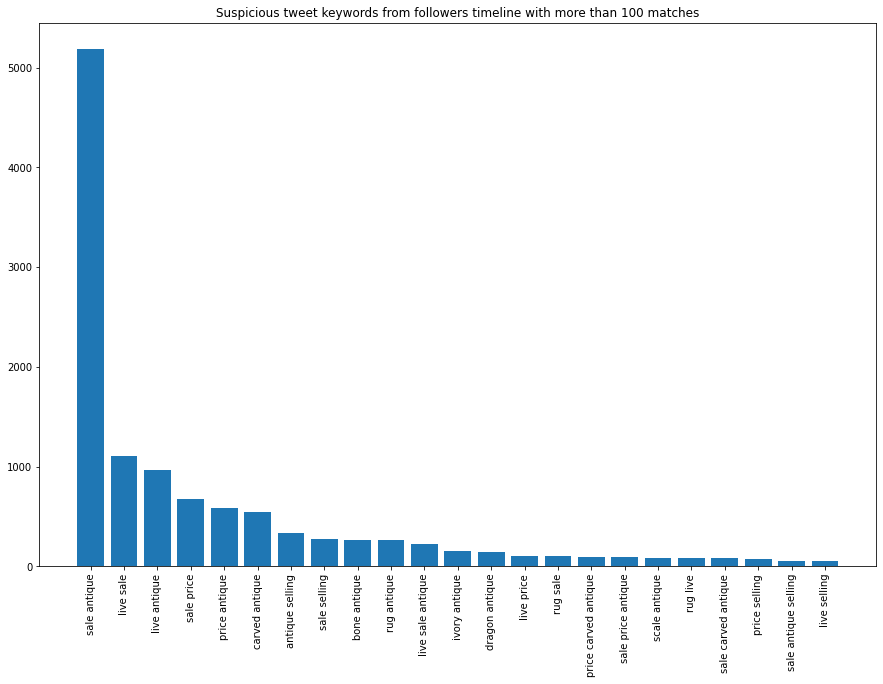

In [15]:
# Remove items with 1 count
suspicious_tweets_word_map_sorted = [x for x in suspicious_tweets_word_map_sorted if x[1] > 50]
plt.figure(figsize=(15,10))
plt.bar(range(len(suspicious_tweets_word_map_sorted)), [x[1] for x in suspicious_tweets_word_map_sorted], align='center')
plt.xticks(range(len(suspicious_tweets_word_map_sorted)), [x[0] for x in suspicious_tweets_word_map_sorted], rotation=90)
plt.title("Suspicious tweet keywords from followers timeline with more than 100 matches")
plt.show()

In [16]:
# Write user_analysis_json to json file
with open('../../data/followers_timeline_analysis.json', 'w') as outfile:
	json.dump(followers_analysis_json, outfile, indent=4)